## Data Exploration
create date: 02/09/2020
modify date: 02/10/2020

this script is to explore the data framework and structure and make a series of plot shown in the pdf

In [1]:
import gzip
import json
import pandas as pd
import numpy as np

In [2]:
path='/Users/mzhang/Desktop/SQL/code/telematics_work_sample/'

In [3]:
with gzip.open(path+'mobile_trips.json.gz', "rb") as f:
    mobile = json.loads(f.read().decode("ascii"))
    
with gzip.open(path+'obd2_trips.json.gz', "rb") as f:
    obd2 = json.loads(f.read().decode("ascii"))

In [ ]:
pd.DataFrame(mobile).shape

In [ ]:
pd.DataFrame(obd2).shape

In [ ]:
# view the example from mobile data
j=1
for i in range(5):
    print(mobile[j][i])

there are 5 variables in mobile data: trip_id, created_at, timestamp, speed and accuracy

In [ ]:
# check if 'created_at' values are identical given 'trip_id'
j=1
test= pd.DataFrame(columns=['created_at'], index=range(len(mobile[j])))
cnt=0
for i in range(len(mobile[j])):
    test.loc[cnt, 'created_at']=mobile[j][i]['created_at']
    cnt+=1

In [ ]:
set(test.created_at) # it's identical

In [ ]:
# view the example from obd2 data
j=1
for i in range(5):
    print(obd2[j][i])

there are only 3 variables in obd2 data: trip_id, timestamp and speed. The timestamp in the 2 data are relative to different reference.

In [ ]:
# make the table to count how many records were taken given each trip_id for mobile data

mobile_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(mobile)))
cnt= 0

for i in range(len(mobile)):
    mobile_table.loc[cnt, 'trip_id']= mobile[i][0]['trip_id']
    mobile_table.loc[cnt, 'records']= len(mobile[i])
    cnt+=1

In [ ]:
mobile_table.head()

In [ ]:
# # make the table to count how many records were taken given each trip_id for obd2 data

obd2_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(obd2)))
cnt= 0

for i in range(len(obd2)):
    obd2_table.loc[cnt, 'trip_id']= obd2[i][1]['trip_id']
    obd2_table.loc[cnt, 'records']= len(obd2[i])
    cnt+=1

In [ ]:
obd2_table.head()

the time records for both data are irregular

#### Find the right time reference

Since the timestamp is relative to different reference, I first need to convert to the same/close scale in order to find the matched interval. Based on the notice in the introduction pdf, it uses (epoch) second. So I convert epoch to human-readable date

In [18]:
import datetime
import time
fmt = "%a, %d %b %Y %H:%M:%S %Z"

In [19]:
j=1
for i in range(5):
    s= mobile[j][i]['timestamp']
    t = time.strftime("%a, %d %b %Y %H:%M:%S %Z", time.localtime(s))

    print('time: ', t)

time:  Sat, 13 May 2017 08:51:02 PDT
time:  Sat, 13 May 2017 08:51:03 PDT
time:  Sat, 13 May 2017 08:51:04 PDT
time:  Sat, 13 May 2017 08:51:05 PDT
time:  Sat, 13 May 2017 08:51:06 PDT


In [20]:
%matplotlib inline
import matplotlib.pyplot as plt

In [ ]:
# draw a few plots to check if the two times are on the same scale now

for i in range(5):
    mobile_id= mobile[i][0]['trip_id']
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        cnt+=1
    
    x1= mobile_time['sec']
    y1= [value['speed'] for value in mobile[i]]
    
    
    for j in range(5):
        obd2_id= obd2[j][0]['trip_id']
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]

        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.show()
        
#for i in range(len(mobile)):
#    mobile_id= mobile[i][0]['trip_id']
    
#    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec'], index= range(len(mobile[i])))
#    cnt=0
#    for value in mobile[i]:
#        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
#        end= datetime.datetime.fromtimestamp(float(value['created_at']))
#        mobile_time.loc[cnt, 'start']= start
#        mobile_time.loc[cnt, 'end']= end
#        mobile_time.loc[cnt, 'sec'] = (end- start).total_seconds() 
#        cnt+=1
    
#    x1= mobile_time['sec']
#    y1= [value['speed'] for value in mobile[i]]
    
    
    
#    for j in range(len(obd2)):
#        obd2_id= obd2[j][0]['trip_id']
        
#        x2= [value['timestamp'] for value in obd2[j]] 
#        y2= [value['speed'] for value in obd2[j]]

#        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
#        plt.title(title)
#        plt.xlabel('time')
#        plt.ylabel('speed')
#        plt.plot(x1, y1, label='mobile')
#        plt.plot(x2, y2, label='obd2')
#        plt.legend()
#        plt.savefig(path + 'Root_project/figure/' + mobile_id +'-'+ obd2_id)
#        plt.show()        
        

two times are roughly on the same scale and next I'm using dynamic time warping (DTW) to compare two signals

In [21]:
import numpy as np
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw

In [36]:
dist_table= pd.DataFrame(columns=['mobile_id', 'obd2_id', 'distance'], index=range(len(mobile)*len(obd2)))
cnt=0

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    y1= [value['speed'] for value in mobile[i]]
    
    if sum(y1)==0:
        continue
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        y2= [value['speed'] for value in obd2[j]]
        
        if sum(y2)==0:
            continue
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        d, p = fastdtw(y1, y2, dist=euclidean)
        
        dist_table.loc[cnt, 'mobile_id']= mobile_id
        dist_table.loc[cnt, 'obd2_id']= obd2_id
        dist_table.loc[cnt, 'distance']= d
        
        cnt+=1

In [37]:
dist_table.head()

,mobile_id,obd2_id,distance
0,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000000,44.206
1,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000002,63.8161
2,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000003,59.5073
3,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000010,61.9564
4,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000011,72.8701


In [38]:
dist_table.to_csv(path+'DTW_dist_normalize_table.csv', index=None, sep=',')

### load DTW distance table

In [22]:
dist_table= pd.read_csv(path+'DTW_dist_table.csv', sep=',')

In [23]:
dist_table.shape

(1804, 3)

In [24]:
dist_table.head()

,mobile_id,obd2_id,distance
0,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000000,53908.0263
1,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000002,68324.5039
2,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000003,44579.7663
3,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000010,45769.2663
4,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000011,16817.4363


In [39]:
cutoff= np.percentile(dist_table.distance, 5)
print(cutoff)

dist_table_top = dist_table[dist_table.distance<=cutoff]

54.85079208096532


In [40]:
# select the top 10% percentile mobile_id
mobile_select= set(dist_table_top.mobile_id)

mobile_list=[]

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id in mobile_select:
        mobile_list.append(mobile_id)

# select the top 10% percentile obd2_id
obd2_select= set(dist_table_top.obd2_id)

obd2_list=[]

for i in range(len(obd2)):
    obd2_id= obd2[i][0]['trip_id']
    
    if obd2_id in obd2_select:
        obd2_list.append(obd2_id)

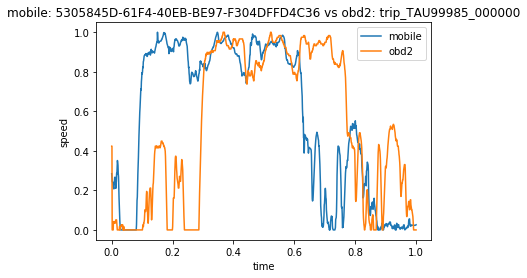

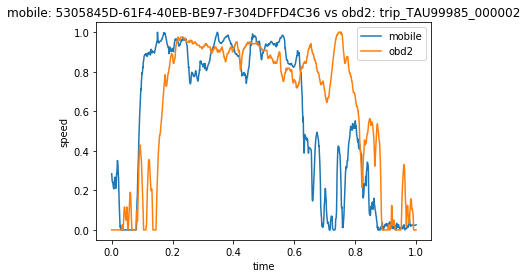

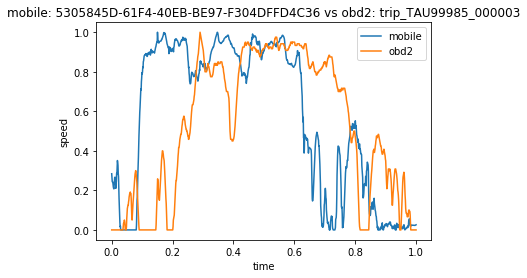

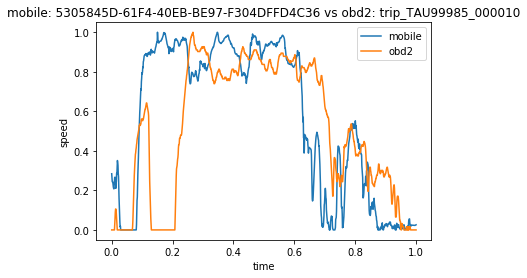

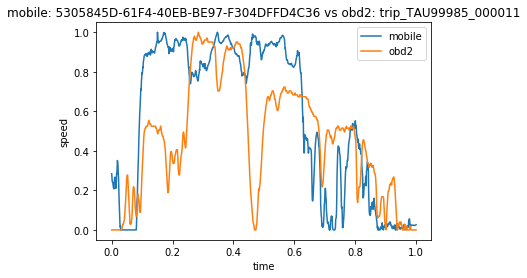

...

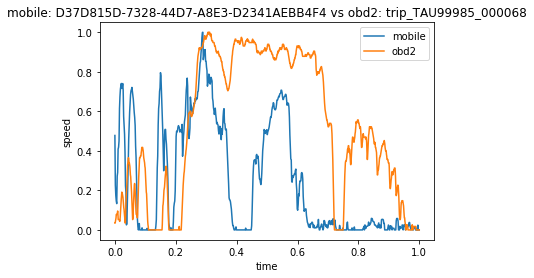

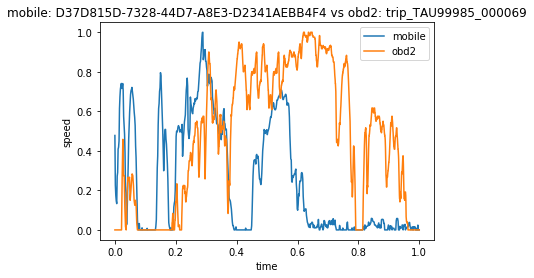

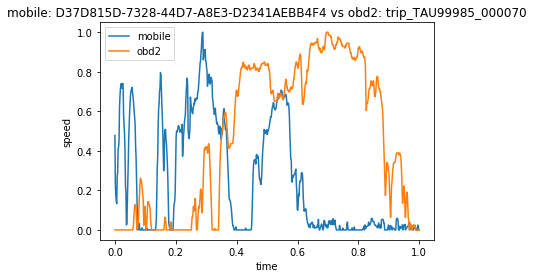

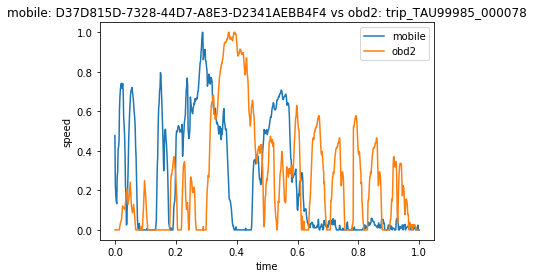

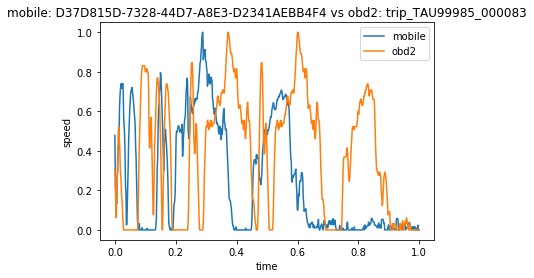

In [41]:
for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        cnt+=1
    
    x1= mobile_time['sec']
    y1= [value['speed'] for value in mobile[i]]
    if sum(y1)==0:
        continue
        
    x1= np.asarray(x1)
    x1= (x1-min(x1))/(max(x1)-min(x1))    
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed']/2 for value in obd2[j]]
        if sum(y2)==0:
            continue
        
        x2= np.asarray(x2)
        x2= (x2-min(x2))/(max(x2)-min(x2))
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.savefig(path + 'figure/' + mobile_id +'-'+ obd2_id)
        plt.show()